In [1]:
from desc.grid import Grid
from desc.plotting import plot_surfaces, plot_3d
from desc.geometry import FourierRZToroidalSurface
from desc.equilibrium import Equilibrium
from desc.continuation import solve_continuation_automatic
import jax.numpy as jnp

DESC version 0+untagged.6625.gbb8d59b,using JAX backend, jax version=0.4.14, jaxlib version=0.4.14, dtype=float64
Using device: CPU, with 1.08 GB available memory


In [2]:
surf = FourierRZToroidalSurface(
    R_lmn=jnp.array([1, -0.1, 0.04, 0.03]),  # boundary coefficients
    Z_lmn=jnp.array([0.1, -0.03, -0.03]),
    modes_R=jnp.array(
        [[0, 0], [1, 0], [1, 1], [-1, -1]]
    ),  # [M, N] boundary Fourier modes
    modes_Z=jnp.array([[-1, 0], [-1, 1], [1, -1]]),
    NFP=5,  # number of (toroidal) field periods
)
eq = Equilibrium(M=1, N=1, Psi=1, surface=surf)
eq = solve_continuation_automatic(eq, objective="force", bdry_step=0.5, verbose=3)[-1]
#eq.Psi = eq.Psi/19

Step 1
Spectral indexing: ansi
Spectral resolution (L,M,N)=(1,1,0)
Node resolution (L,M,N)=(2,2,0)
Boundary ratio = 0
Pressure ratio = 0
Current ratio = 1
Perturbation Order = 2
Objective: force
Optimizer: lsq-exact
Building objective: force
Precomputing transforms
Timer: Precomputing transforms = 2.75 sec
Timer: Objective build = 6.06 sec
Timer: Linear constraint projection build = 5.99 sec
Compiling objective function and derivatives: ['force']
Timer: Objective compilation time = 1.61 sec
Timer: Jacobian compilation time = 14.8 sec
Timer: Total compilation time = 16.4 sec
Number of parameters: 1
Number of objectives: 8
Starting optimization
Using method: lsq-exact
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1          6.677e-03                                    1.335e-01   
       1              2          4.508e-05      6.632e-03      9.856e-02      1.886e-03   
       2              3          4.373e-05      1.35

In [3]:
eq.save("eq_2411_M1_N1.h5")


In [4]:
# plot_3d(eq, "B")
iota = eq.compute("iota")["iota"]
iota

Array([0.09982763, 0.09982763, 0.09982763, 0.09982763, 0.09982763,
       0.09894795, 0.09894795, 0.09894795, 0.09894795, 0.09894795,
       0.09749745, 0.09749745, 0.09749745, 0.09749745, 0.09749745,
       0.09982763, 0.09982763, 0.09982763, 0.09982763, 0.09982763,
       0.09894795, 0.09894795, 0.09894795, 0.09894795, 0.09894795,
       0.09749745, 0.09749745, 0.09749745, 0.09749745, 0.09749745,
       0.09982763, 0.09982763, 0.09982763, 0.09982763, 0.09982763,
       0.09894795, 0.09894795, 0.09894795, 0.09894795, 0.09894795,
       0.09749745, 0.09749745, 0.09749745, 0.09749745, 0.09749745,
       0.09982763, 0.09982763, 0.09982763, 0.09982763, 0.09982763,
       0.09894795, 0.09894795, 0.09894795, 0.09894795, 0.09894795,
       0.09749745, 0.09749745, 0.09749745, 0.09749745, 0.09749745,
       0.09982763, 0.09982763, 0.09982763, 0.09982763, 0.09982763,
       0.09894795, 0.09894795, 0.09894795, 0.09894795, 0.09894795,
       0.09749745, 0.09749745, 0.09749745, 0.09749745, 0.09749

: 

In [12]:
from desc.objectives import ParticleTracer
import scipy.constants

# Energy and Mass info
Energy_eV = 1e2 #1 # eV (3.52e6 eV proton energy)
Proton_Mass = scipy.constants.proton_mass
Proton_Charge = scipy.constants.elementary_charge
Energy_SI = Energy_eV*Proton_Charge

# Particle Info
Mass = 4*Proton_Mass
Charge = 2*Proton_Charge

# Initial State
psi_i = 0.2
zeta_i = 0
theta_i = 0
vpar_i = 0.3*jnp.sqrt(2*Energy_SI/Mass)
ini_cond = [float(psi_i), theta_i, zeta_i, float(vpar_i)]

# Time
tmin = 0
tmax = 1e-3
nt = 1000
time = jnp.linspace(tmin, tmax, nt)

# Initial State
initial_conditions = ini_cond
Mass_Charge_Ratio = Mass/Charge

# Mu 
grid = Grid(jnp.array([jnp.sqrt(psi_i), theta_i, zeta_i]).T, jitable=True, sort=False)
data = eq.compute("|B|", grid=grid)
mu = Energy_SI/(Mass*data["|B|"]) - (vpar_i**2)/(2*data["|B|"])

# Initial Parameters
ini_param = [float(mu), Mass_Charge_Ratio]

# Objective Function
objective = ParticleTracer(eq=eq, output_time=time, initial_conditions=ini_cond, initial_parameters=ini_param, compute_option="optimization", tolerance=1.e-7)

In [18]:
from desc.objectives import ObjectiveFunction
ObjFunction = ObjectiveFunction([objective], deriv_mode="looped")
ObjFunction.build()
ObjFunction.x(eq)


Building objective: Particle Tracer


Array([ 0.03      ,  1.        , -0.1       ,  0.        , -0.01      ,
        0.        , -0.03      ,  0.1       , -0.03      ,  0.09453418,
        0.02449849,  0.09732701,  0.0076153 ,  0.        ,  0.        ,
        1.        ,  1.        ,  0.        ,  0.        ,  0.03      ,
        1.        , -0.1       ,  0.        , -0.01      ,  0.        ,
       -0.03      ,  0.1       , -0.03      ], dtype=float64)

NameError: name 'FourierZernikeBasis' is not defined

(<Figure size 1152x960 with 6 Axes>,
 array([<Axes: title={'center': '$\\phi \\cdot N_{FP}/2\\pi = 0.000$'}, xlabel='$R ~(\\mathrm{m})$', ylabel='$Z ~(\\mathrm{m})$'>,
        <Axes: title={'center': '$\\phi \\cdot N_{FP}/2\\pi = 0.167$'}, xlabel='$R ~(\\mathrm{m})$', ylabel='$Z ~(\\mathrm{m})$'>,
        <Axes: title={'center': '$\\phi \\cdot N_{FP}/2\\pi = 0.333$'}, xlabel='$R ~(\\mathrm{m})$', ylabel='$Z ~(\\mathrm{m})$'>,
        <Axes: title={'center': '$\\phi \\cdot N_{FP}/2\\pi = 0.500$'}, xlabel='$R ~(\\mathrm{m})$', ylabel='$Z ~(\\mathrm{m})$'>,
        <Axes: title={'center': '$\\phi \\cdot N_{FP}/2\\pi = 0.667$'}, xlabel='$R ~(\\mathrm{m})$', ylabel='$Z ~(\\mathrm{m})$'>,
        <Axes: title={'center': '$\\phi \\cdot N_{FP}/2\\pi = 0.833$'}, xlabel='$R ~(\\mathrm{m})$', ylabel='$Z ~(\\mathrm{m})$'>],
       dtype=object))

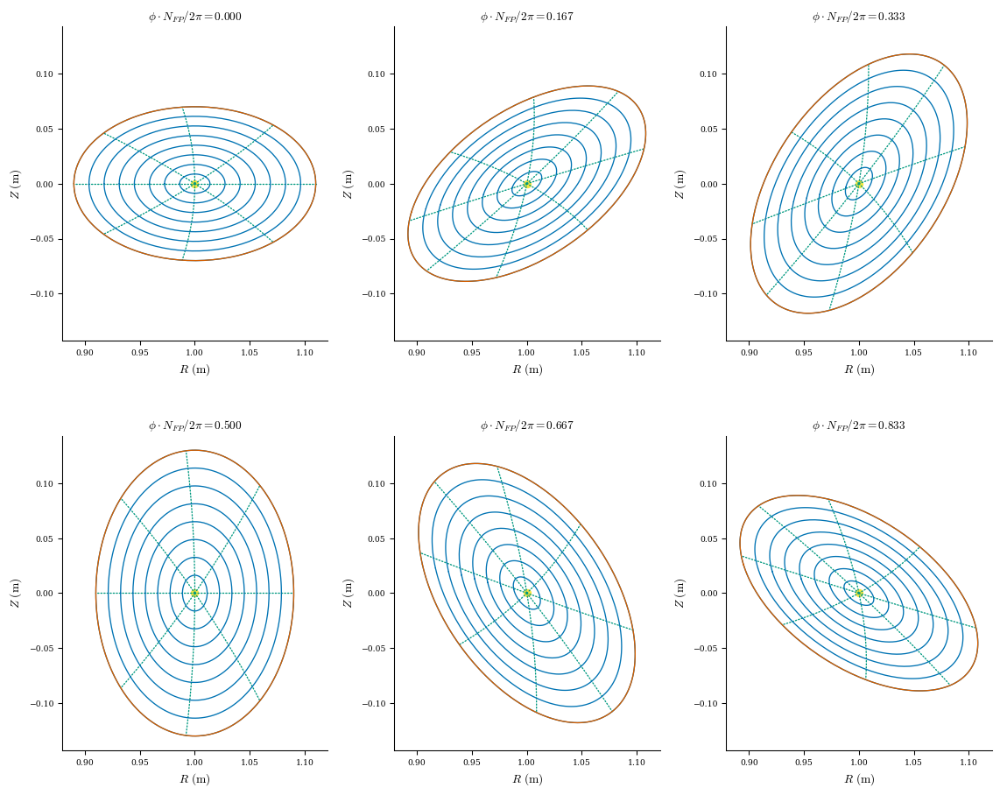

In [4]:
plot_surfaces(eq)

In [5]:
plot_3d(eq, "B")

: 

In [4]:
eq.save("rot_ellipse_M1_N1.h5")